# Happywhale - Whale and Dolphin Identification

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import os

# 1. 画像を確認する

In [9]:
import cv2
import torch

In [13]:
base_path = 'res/'
train_df = pd.read_csv(os.path.join(base_path, 'train.csv'))
train_df.head()

,image,species,individual_id
0,00021adfb725ed.jpg,melon_headed_whale,cadddb1636b9
1,000562241d384d.jpg,humpback_whale,1a71fbb72250
2,0007c33415ce37.jpg,false_killer_whale,60008f293a2b
3,0007d9bca26a99.jpg,bottlenose_dolphin,4b00fe572063
4,00087baf5cef7a.jpg,humpback_whale,8e5253662392


In [14]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51033 entries, 0 to 51032
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   image          51033 non-null  object
 1   species        51033 non-null  object
 2   individual_id  51033 non-null  object
dtypes: object(3)
memory usage: 1.2+ MB


In [15]:
train_df['species'].nunique()

30

In [16]:
train_df['species'].unique()

array(['melon_headed_whale', 'humpback_whale', 'false_killer_whale',
       'bottlenose_dolphin', 'beluga', 'minke_whale', 'fin_whale',
       'blue_whale', 'gray_whale', 'southern_right_whale',
       'common_dolphin', 'kiler_whale', 'pilot_whale', 'dusky_dolphin',
       'killer_whale', 'long_finned_pilot_whale', 'sei_whale',
       'spinner_dolphin', 'bottlenose_dolpin', 'cuviers_beaked_whale',
       'spotted_dolphin', 'globis', 'brydes_whale', 'commersons_dolphin',
       'white_sided_dolphin', 'short_finned_pilot_whale',
       'rough_toothed_dolphin', 'pantropic_spotted_dolphin',
       'pygmy_killer_whale', 'frasiers_dolphin'], dtype=object)

In [33]:
# それぞれの出現頻度を表示する
train_df['species'].value_counts() / len(train_df) * 100

bottlenose_dolphin           18.936766
beluga                       14.584681
humpback_whale               14.484745
blue_whale                    9.464464
false_killer_whale            6.517352
dusky_dolphin                 6.150922
spinner_dolphin               3.331178
melon_headed_whale            3.309623
minke_whale                   3.150902
killer_whale                  2.925558
fin_whale                     2.594400
gray_whale                    2.200537
bottlenose_dolpin             2.188780
kiler_whale                   1.885055
southern_right_whale          1.696941
spotted_dolphin               0.960163
sei_whale                     0.838673
short_finned_pilot_whale      0.719143
common_dolphin                0.679952
cuviers_beaked_whale          0.668195
pilot_whale                   0.513393
long_finned_pilot_whale       0.466365
white_sided_dolphin           0.448729
brydes_whale                  0.301766
pantropic_spotted_dolphin     0.284130
globis                   

In [35]:
# もっとも画像が多い、botlenose_dolphineはもっとも画像の少ない'frasiers_dolphinの690倍の数字となっている
train_df['species'].value_counts()[0] / train_df['species'].value_counts()[-1]

690.2857142857143

<AxesSubplot:>

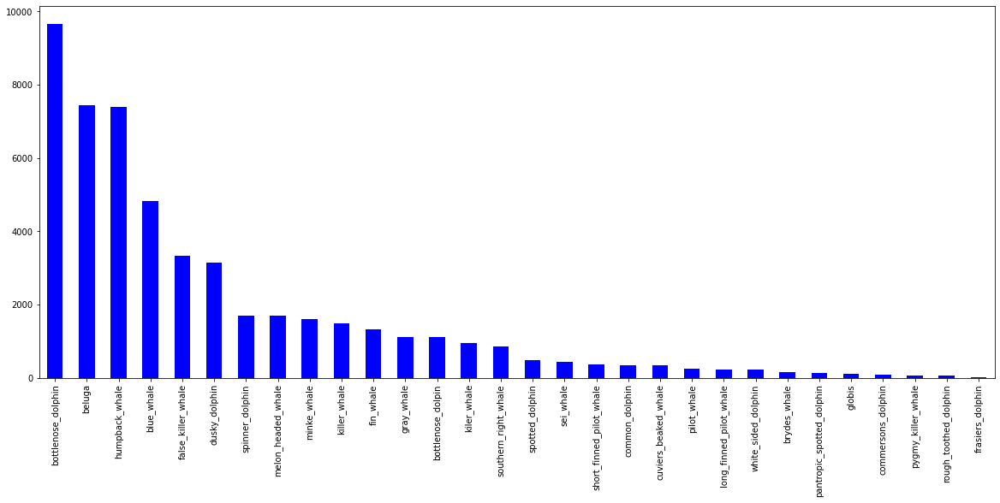

In [36]:
plt.rcParams['figure.figsize'] = 20, 8
plt.figure()
train_df['species'].value_counts().plot(kind="bar", color='b')

In [56]:
train_df['individual_id'].nunique()

15587

In [59]:
# unique_idの数を洗い出す
print('min', train_df['individual_id'].value_counts().min())
print('max', train_df['individual_id'].value_counts().max())
print('mean', train_df['individual_id'].value_counts().mean())
print('std', train_df['individual_id'].value_counts().std())

min 1
max 400
mean 3.274074549303907
std 9.242429572174073


In [75]:
print((train_df['individual_id'].value_counts() == 1).sum() / len(train_df))
print((train_df['individual_id'].value_counts() == 1).sum())

0.18141202751161015
9258


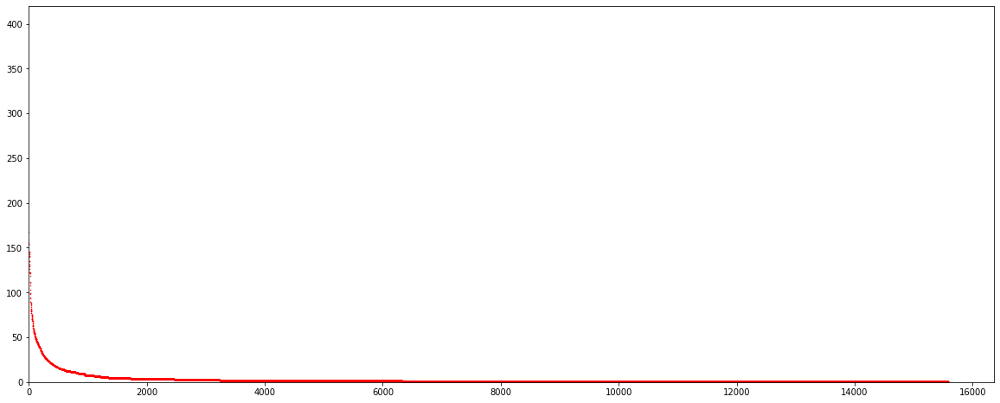

In [78]:
unique_ids = train_df['individual_id'].value_counts()
unique_ids = np.array(unique_ids)
unique_ids[:10]
plt.plot(unique_ids, 'ro', markersize=0.5)
plt.ylim([0, None])
plt.xlim([0, None])
plt.show()

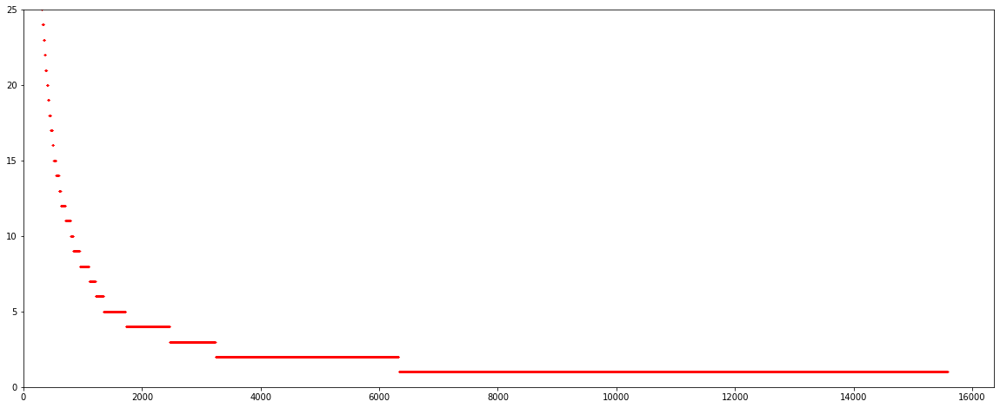

In [79]:
plt.plot(unique_ids, 'ro', markersize=0.5)
plt.ylim([0, 25])
plt.xlim([0, None])
plt.show()

In [83]:
for i in range(1, 20):
    print('uniqueが{}個のidsは{}個'.format(i, (unique_ids == i).sum()))    

# bottlenose_dolphinのunique_idを調べる

In [86]:
bottlenose_dolphin_df = train_df[train_df['species']=='bottlenose_dolphin']
plt.title('bottlenose_dolphinのindividual_idの数')
plt.plot(bottlenose_dolphin_df['individual_id'].value_counts().to_numpy(), 'bo', markersize=1)

/Users/akirakawai/Library/Python/3.8/lib/python/site-packages/IPython/core/pylabtools.py:132: UserWarning: Glyph 12398 (\N{HIRAGANA LETTER NO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/akirakawai/Library/Python/3.8/lib/python/site-packages/IPython/core/pylabtools.py:132: UserWarning: Glyph 25968 (\N{CJK UNIFIED IDEOGRAPH-6570}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


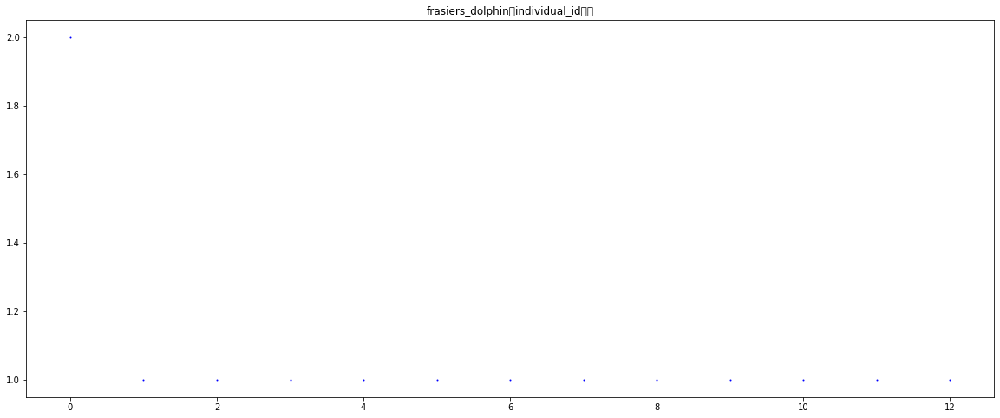

In [97]:
frasiers_dolphin_df = train_df[train_df['species']=='frasiers_dolphin']
plt.title('frasiers_dolphinのindividual_idの数')
plt.plot(frasiers_dolphin_df['individual_id'].value_counts().to_numpy(), 'bo', markersize=1)

/Users/akirakawai/Library/Python/3.8/lib/python/site-packages/IPython/core/pylabtools.py:132: UserWarning: Glyph 12398 (\N{HIRAGANA LETTER NO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/akirakawai/Library/Python/3.8/lib/python/site-packages/IPython/core/pylabtools.py:132: UserWarning: Glyph 25968 (\N{CJK UNIFIED IDEOGRAPH-6570}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


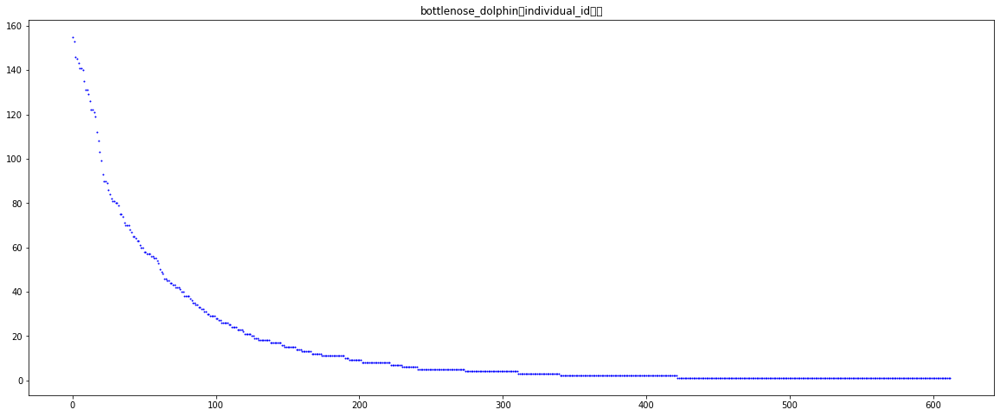

# 全てのspeciesに対して、uniqueなidのヒストグラムを作成する

In [106]:
spieces = train_df['species'].unique()
s_ids_dict = {}
for spiece in spieces:
    current_df = train_df[train_df['species']==spiece]
    s_ids_dict[spiece] = np.array(current_df['individual_id'].value_counts())
# s_ids_dict

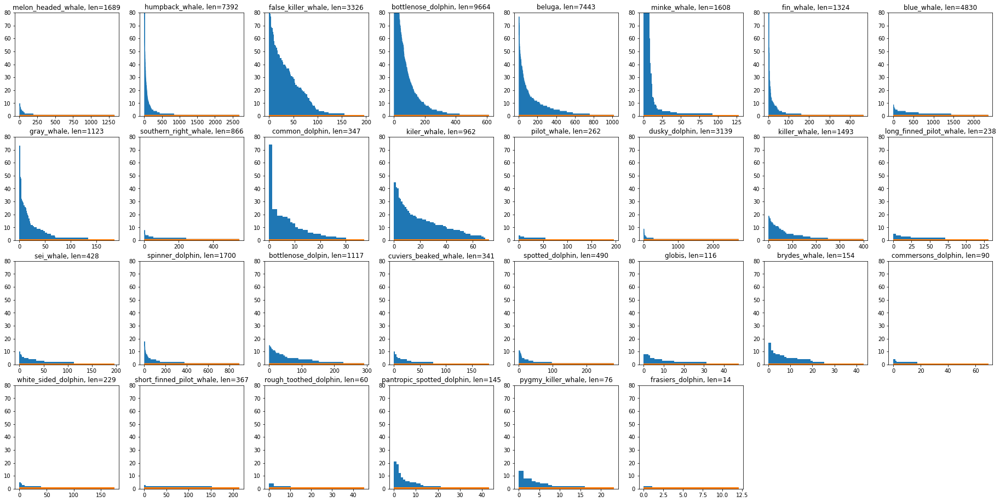

In [121]:
plt.figure(figsize=[32, 16])
for idx, (spiece, count_array) in enumerate(s_ids_dict.items()):
    plt.subplot(4, 8, idx+1)
    plt.title('{}, len={}'.format(spiece, count_array.sum()))
    plt.fill_between(range(len(count_array)), 0, count_array, color='C0', step='post')
    plt.fill_between(range(len(count_array)), 0, 1, color='C1', step='post')
    plt.ylim([0, 80])
plt.show()    

# 考察
- 大半が識別ID、一つのみのものである
- 絶対数が多くても、上位10IDに数が集中している場合が多い
- もっとも多数の識別が可能そうなのは、kiler_whaleの可能性が高い（理由：満遍なく分布しているから）


uniqueが1個のidsは9258個
uniqueが2個のidsは3091個
uniqueが3個のidsは773個
uniqueが4個のidsは741個
uniqueが5個のidsは374個
uniqueが6個のidsは135個
uniqueが7個のidsは108個
uniqueが8個のidsは158個
uniqueが9個のidsは111個
uniqueが10個のidsは43個
uniqueが11個のidsは89個
uniqueが12個のidsは79個
uniqueが13個のidsは29個
uniqueが14個のidsは51個
uniqueが15個のidsは42個
uniqueが16個のidsは17個
uniqueが17個のidsは32個
uniqueが18個のidsは25個
uniqueが19個のidsは19個


# 実際に画像を表示してみる

In [84]:
bottlenose_dolphin_df = train_df[train_df['species']=='bottlenose_dolphin']

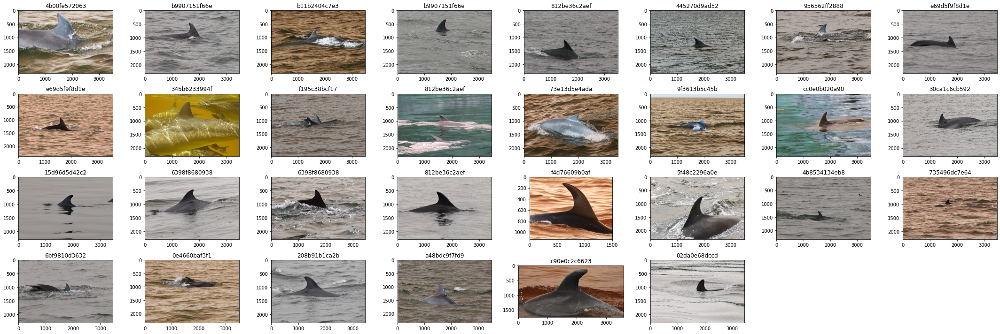

In [123]:
train_image_base_path = os.path.join(base_path, 'train_images')

plt.figure(figsize=[30, 10])
for i in range(30):
    plt.subplot(4, 8, i+1)
    image_path = os.path.join(train_image_base_path, bottlenose_dolphin_df.iloc[i]['image'])
    image = cv2.imread(image_path)
    plt.title(bottlenose_dolphin_df.iloc[i]['individual_id'])
    plt.imshow(image)
plt.tight_layout()
plt.show()

melon_headed_whale


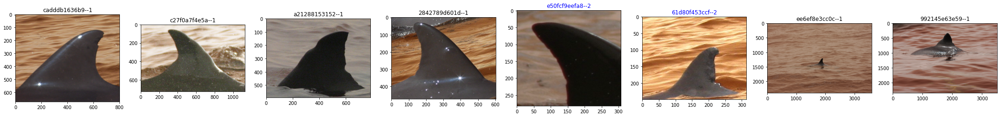

humpback_whale


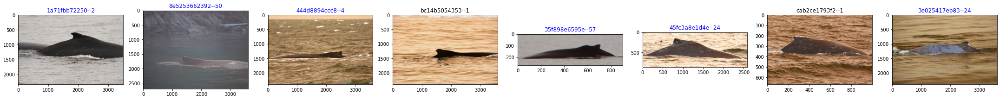

false_killer_whale


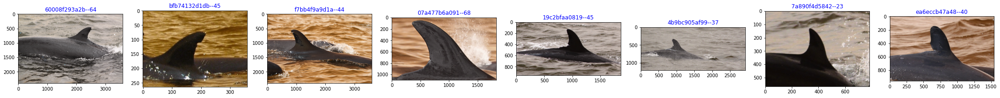

bottlenose_dolphin


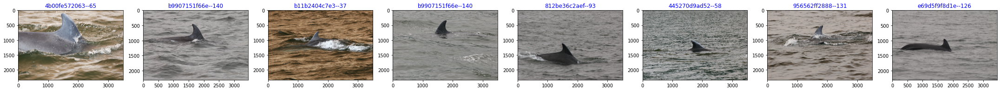

beluga


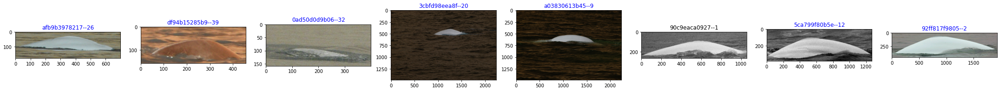

minke_whale


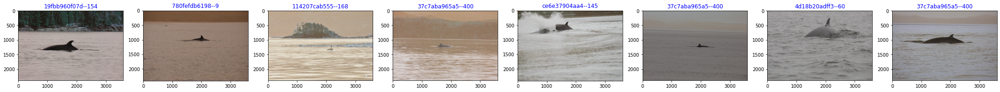

fin_whale


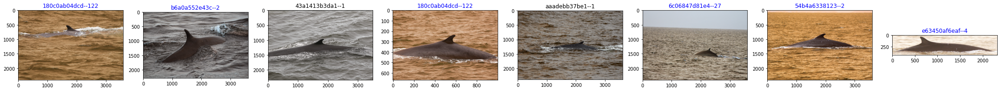

blue_whale


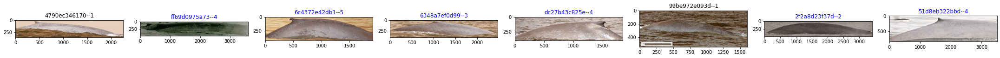

gray_whale


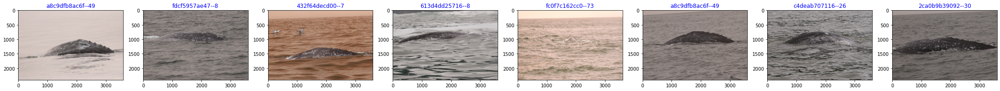

southern_right_whale


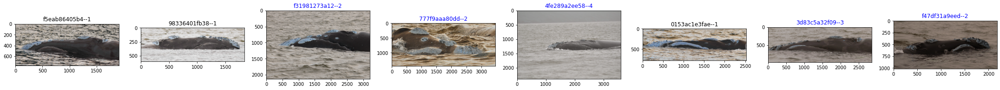

common_dolphin


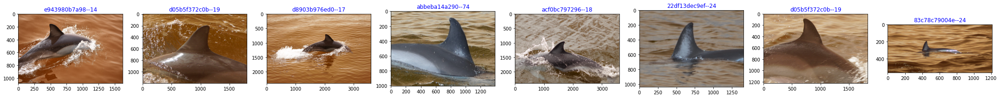

kiler_whale


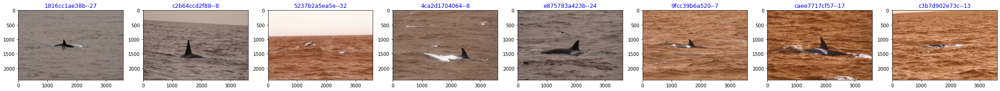

pilot_whale


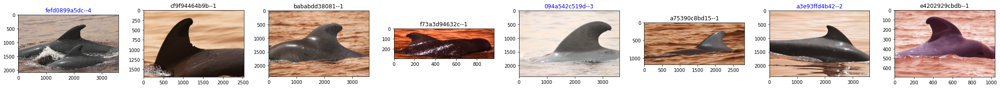

dusky_dolphin


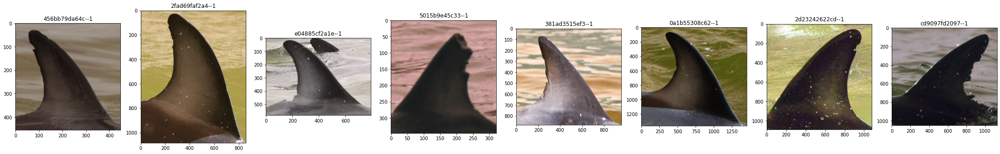

killer_whale


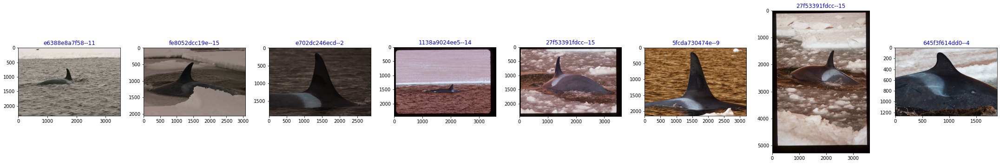

long_finned_pilot_whale


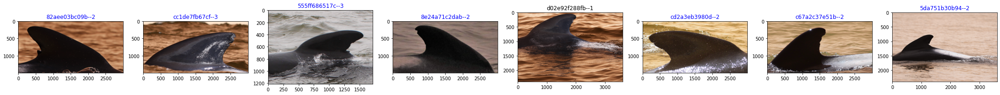

sei_whale


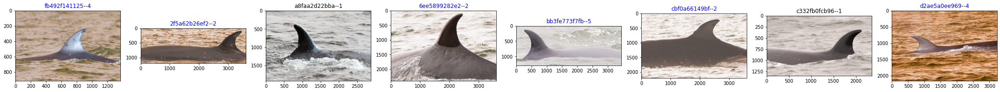

spinner_dolphin


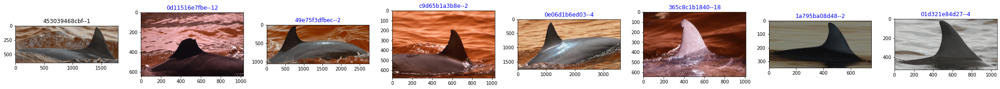

bottlenose_dolpin


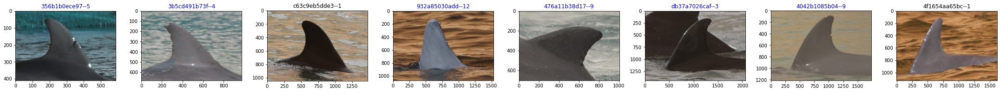

cuviers_beaked_whale


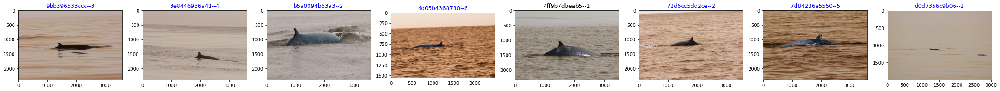

spotted_dolphin


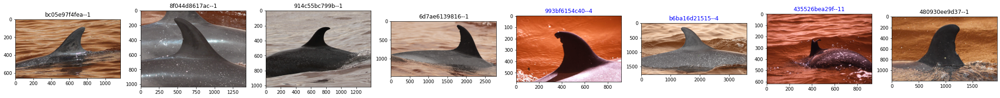

globis


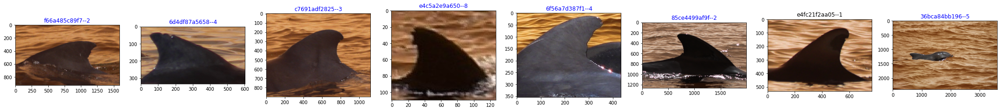

brydes_whale


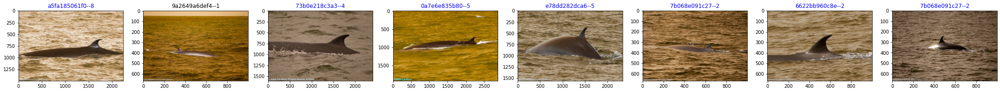

commersons_dolphin


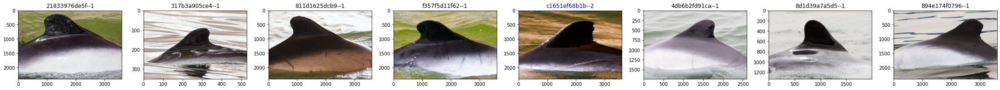

white_sided_dolphin


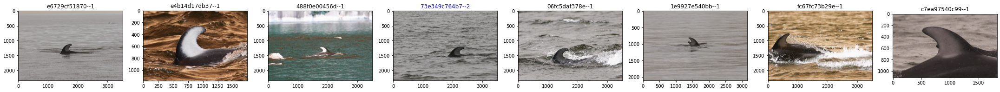

short_finned_pilot_whale


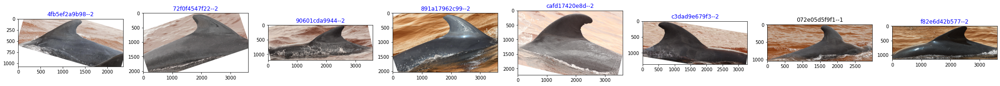

rough_toothed_dolphin


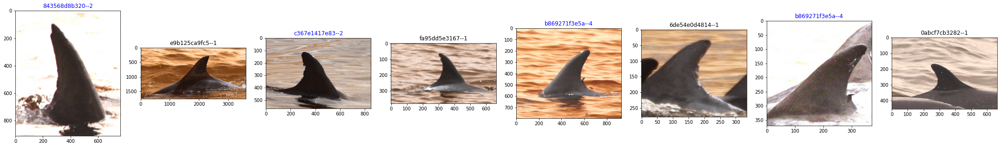

pantropic_spotted_dolphin


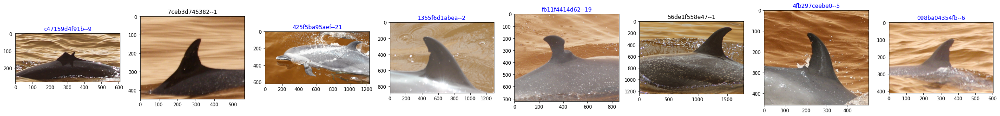

pygmy_killer_whale


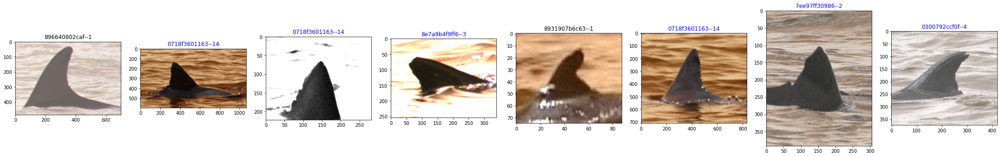

frasiers_dolphin


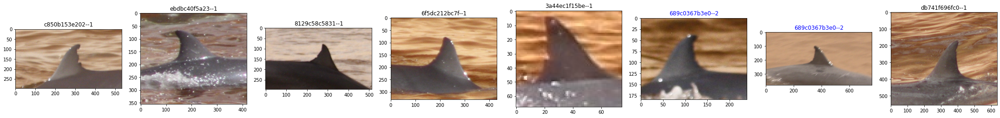

In [131]:
spieces = train_df['species'].unique()
for spiece in spieces:
    current_df = train_df[train_df['species']==spiece]
    print(spiece)
    plt.figure(figsize=[30, 5])
    for i in range(8):
        num_ids = current_df[current_df['individual_id']==current_df.iloc[i]['individual_id']].value_counts().sum()
        image_path = os.path.join(base_path, 'train_images', current_df.iloc[i]['image'])
        image = cv2.imread(image_path)
        plt.subplot(1, 8, i+1)
        plt.imshow(image)
        if num_ids != 1:
            plt.title('{} {}ids'.format(current_df.iloc[i]['individual_id'], num_ids), color='b')
        else:
            plt.title('{} {}ids'.format(current_df.iloc[i]['individual_id'], num_ids))
        plt.tight_layout()
    plt.show()

melon_headed_whale--->最も確認されたidは 942976a11d81 で出現数は 10 枚


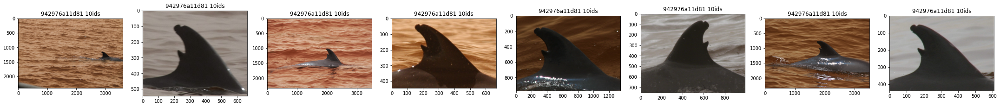

humpback_whale--->最も確認されたidは 938b7e931166 で出現数は 135 枚


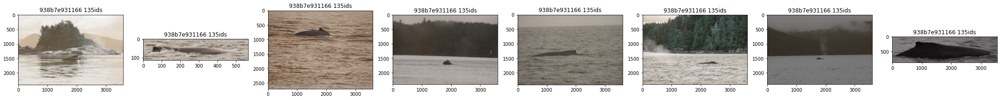

false_killer_whale--->最も確認されたidは 2fdb3a09dc9c で出現数は 88 枚


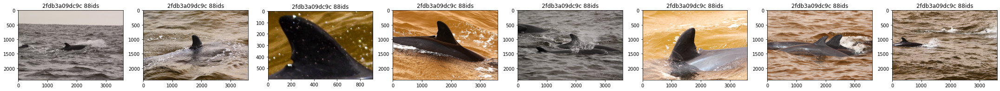

bottlenose_dolphin--->最も確認されたidは a6e325d8e924 で出現数は 155 枚


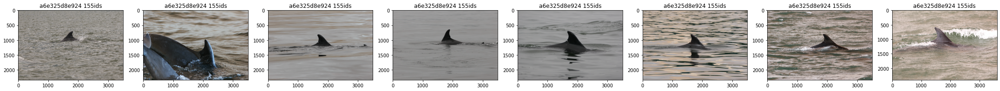

beluga--->最も確認されたidは 322a18725969 で出現数は 77 枚


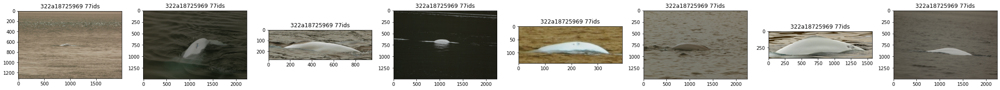

minke_whale--->最も確認されたidは 37c7aba965a5 で出現数は 400 枚


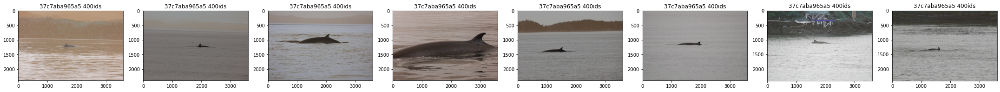

fin_whale--->最も確認されたidは 180c0ab04dcd で出現数は 122 枚


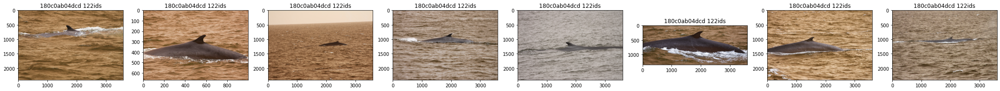

blue_whale--->最も確認されたidは a56b48593757 で出現数は 9 枚


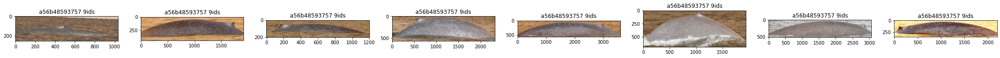

gray_whale--->最も確認されたidは fc0f7c162cc0 で出現数は 73 枚


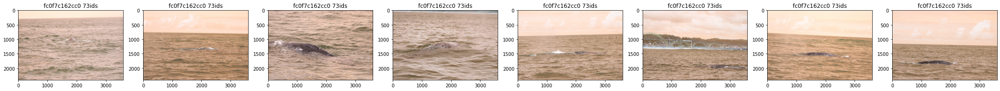

southern_right_whale--->最も確認されたidは f5ff2e2e7df6 で出現数は 8 枚


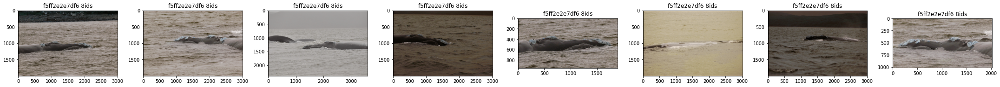

common_dolphin--->最も確認されたidは abbeba14a290 で出現数は 74 枚


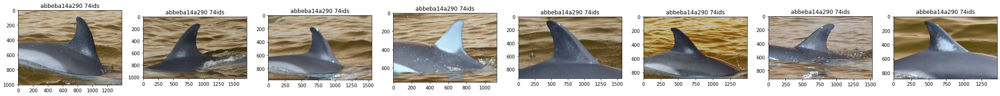

kiler_whale--->最も確認されたidは ef0ddd083fbe で出現数は 45 枚


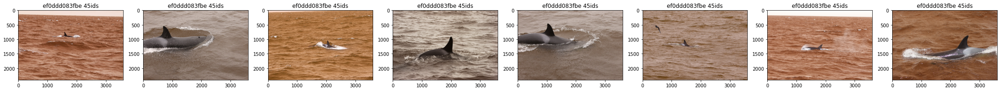

pilot_whale--->最も確認されたidは fefd0899a5dc で出現数は 4 枚


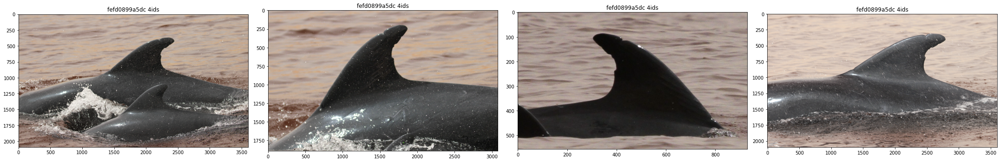

dusky_dolphin--->最も確認されたidは 825624bb225f で出現数は 9 枚


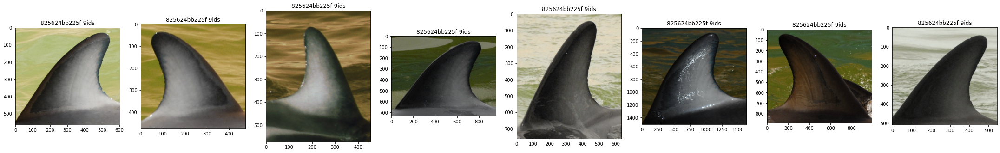

killer_whale--->最も確認されたidは c007ade3c628 で出現数は 19 枚


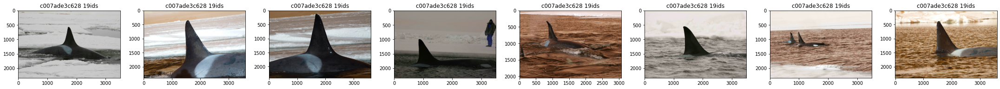

long_finned_pilot_whale--->最も確認されたidは 232237283087 で出現数は 5 枚


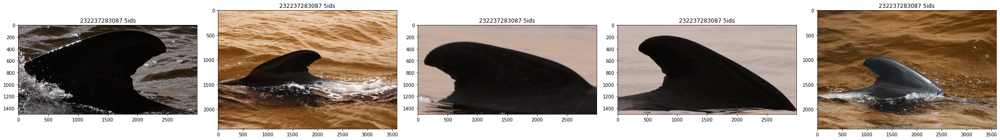

sei_whale--->最も確認されたidは 770958720c56 で出現数は 10 枚


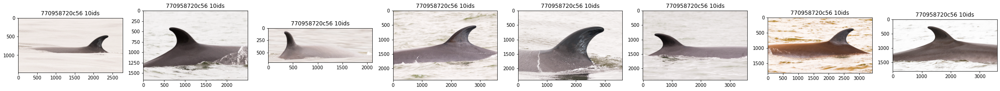

spinner_dolphin--->最も確認されたidは 365c8c1b1840 で出現数は 18 枚


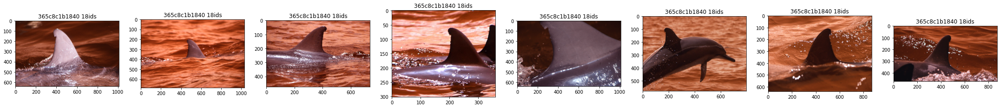

bottlenose_dolpin--->最も確認されたidは 1f131241029a で出現数は 15 枚


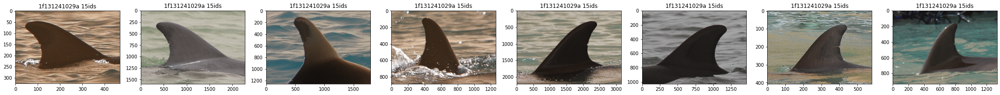

cuviers_beaked_whale--->最も確認されたidは 85c8631dfffe で出現数は 10 枚


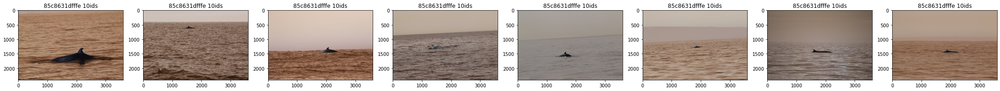

spotted_dolphin--->最も確認されたidは 435526bea29f で出現数は 11 枚


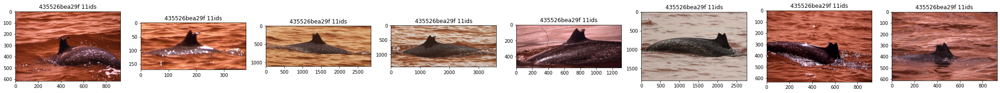

globis--->最も確認されたidは 2788fab75091 で出現数は 8 枚


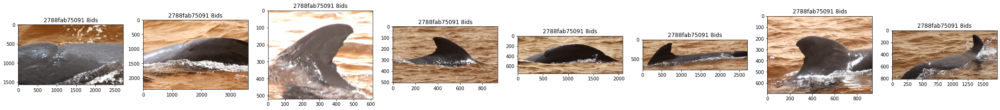

brydes_whale--->最も確認されたidは 83afdba5e8e5 で出現数は 17 枚


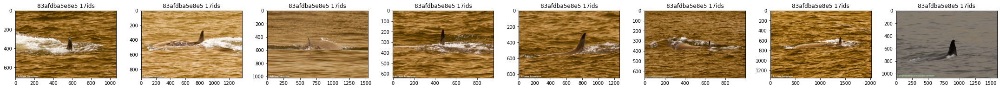

commersons_dolphin--->最も確認されたidは 291bf3316e8e で出現数は 4 枚


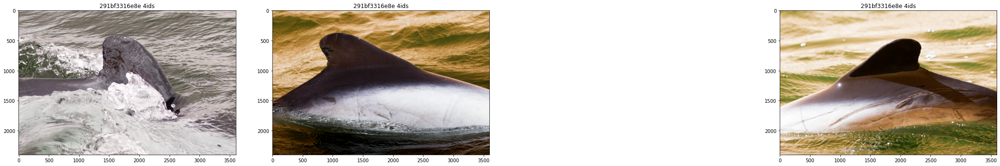

white_sided_dolphin--->最も確認されたidは 7cdf6b577ca5 で出現数は 5 枚


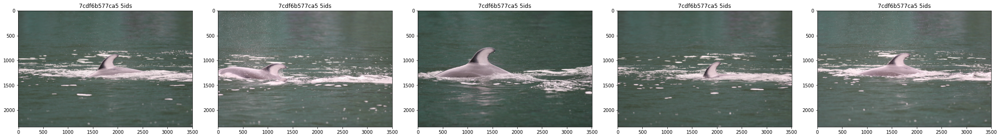

short_finned_pilot_whale--->最も確認されたidは 46b4fc60cf44 で出現数は 3 枚


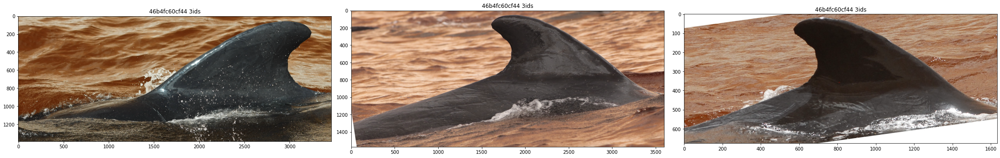

rough_toothed_dolphin--->最も確認されたidは 1f83437d3f04 で出現数は 4 枚


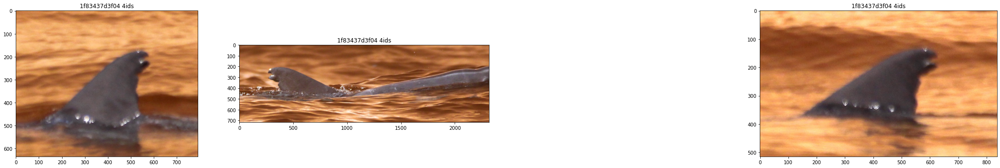

pantropic_spotted_dolphin--->最も確認されたidは 425f5ba95aef で出現数は 21 枚


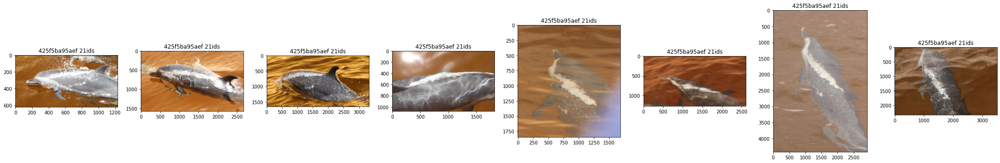

pygmy_killer_whale--->最も確認されたidは 0718f3601163 で出現数は 14 枚


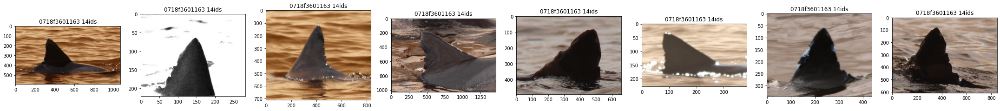

frasiers_dolphin--->最も確認されたidは 689c0367b3e0 で出現数は 2 枚


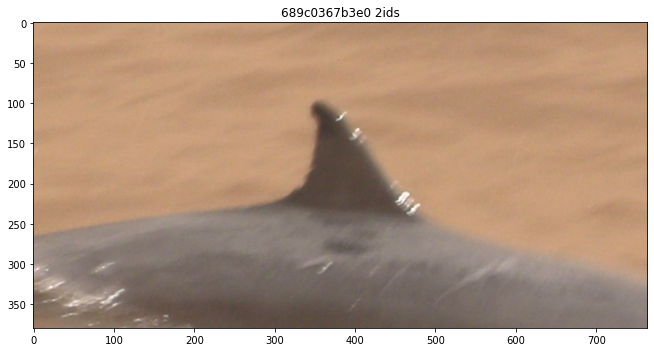

In [154]:
for spiece in spieces:
    current_df = train_df[train_df['species']==spiece]
    most_confirmed_id = current_df['individual_id'].value_counts().index[0]
    num_most_confirmed_id = current_df['individual_id'].value_counts()[0]
    
    print('{}--->最も確認されたidは {} で出現数は {} 枚'.format(spiece, most_confirmed_id, num_most_confirmed_id))
    
    most_df = current_df[current_df['individual_id']==most_confirmed_id]
    
    if len(most_df) < 8:
        num_plots = len(most_df)
    else:
        num_plots = 8
        
    plt.figure(figsize=[30, 5])
    for i in range(num_plots):
        image_path = os.path.join(base_path, 'train_images', most_df.iloc[i]['image'])
        image = cv2.imread(image_path)
        plt.subplot(1, num_plots, i+1)
        plt.imshow(image)
        plt.title('{} {}ids'.format(most_confirmed_id, len(most_df)))
        plt.tight_layout()
    plt.show()

# 考察

- 種類を当てるだけでもかなり難易度高そう。
- そもそも、train_imagesの種類あっているのだろうか。
- 部位がかなり映っているように見えても、識別できていないidも多い
- 海の中にポツンと映っているだけで識別されているidも存在する
- gray_whaleは、認識方法がサイズ感なのか、ほとんど映っていない画像でも同じIDとしてラベル付けされている
- killer_whaleとkiler_whaleは別品種なのか？typo？

## 方針
- 正攻法で、speciesの分類->idの分類という形で推論していく形
- いきなりidを推論し、難しい場合はspecies分類してから割り当てていく
- まずは、正攻法でやっていくか...